### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [5]:
DATA_VERSION = 'v5'

In [6]:
fig_dir = '../' + DATA_VERSION + '-fig/fig-cgis-no-eu/SCCS/'

In [7]:
cgi_csv = '../data/' + DATA_VERSION + '/institutions_data_prepped.csv'

In [8]:
cgi_df = pd.read_csv(cgi_csv)

In [9]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanism

In [10]:
# Drop Region: Europe
cgi_df = cgi_df[cgi_df['Region: Europe'] != 1]
cgi_df['Region: Europe'].sum()

np.int64(0)

In [11]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanism

Note: CGI -> CGI *mechanisms*

In [12]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [13]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanism

In [14]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['decision_making_cgis_include_quorum',
 'decision_making_cgis_include_ratification_acclamation_only',
 'enforcement_cgis_include_appeal',
 'decision_making_cgis_include_checks_and_balances',
 'enforcement_cgis_include_criticism_mocking_joking',
 'decision_making_cgis_include_representation',
 'decision_making_cgis_include_public_meetings',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_property_requirement',
 'decision_making_cgis_include_turnover_rotation',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_consensus',
 'enforcement_cgis_include_graduated_sanctions',
 'enforcement_cgis_include_capital_punishment',
 'access_cgis_include_blood_relations',
 'access_cgis_include_gerontocracy',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_assembly_central',
 'decision_making_cgis_include_majority_voting',
 'decision_making_cgis_include_remunerated_position',
 'access_cgis_include_age_boundaries',
 'decision_making_

In [15]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [16]:
cgi_mechanisms_df

,decision_making_cgis_include_quorum,decision_making_cgis_include_ratification_acclamation_only,enforcement_cgis_include_appeal,decision_making_cgis_include_checks_and_balances,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_representation,decision_making_cgis_include_public_meetings,access_cgis_include_patronage_for_office,access_cgis_include_property_requirement,decision_making_cgis_include_turnover_rotation,decision_making_cgis_include_assembly_local,decision_making_cgis_include_consensus,enforcement_cgis_include_graduated_sanctions,enforcement_cgis_include_capital_punishment,access_cgis_include_blood_relations,access_cgis_include_gerontocracy,decision_making_cgis_include_consent,decision_making_cgis_include_assembly_central,decision_making_cgis_include_majority_voting,decision_making_cgis_include_remunerated_position,access_cgis_include_age_boundaries,decision_making_cgis_include_supermajority,enforcement_cgis_include_negotiation,access_cgis_include_meritocracy,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_consultation,decision_making_cgis_include_unanimity,access_cgis_include_payment_for_occupying_office,enforcement_cgis_include_judicial_review,enforcement_cgis_include_corporal_punishment_violence_against_perpetrator,access_cgis_include_child_participation,access_cgis_include_female_participation,decision_making_cgis_include_council_local,access_cgis_include_heredity,access_cgis_include_election,decision_making_cgis_include_group_voting,enforcement_cgis_include_exit,decision_making_cgis_include_vote_by_proxy,enforcement_cgis_include_litigation,decision_making_cgis_include_vote_by_show_of_hands,decision_making_cgis_include_voting,decision_making_cgis_include_frequent_and_or_regular_meetings,decision_making_cgis_include_secret_ballot,access_cgis_include_co-optation,decision_making_cgis_include_veto,decision_making_cgis_include_assembly_elite,access_cgis_include_lottery_random_selection,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_screening_process,enforcement_cgis_include_tribunal_court_,enforcement_cgis_include_arbitration,decision_making_cgis_include_plurality_voting,enforcement_cgis_include_fines,enforcement_cgis_include_mediation,decision_making_cgis_include_council_central_,decision_making_cgis_include_delegation,decision_making_cgis_include_gathering,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_board_committee,decision_making_cgis_include_deliberation,decision_making_cgis_include_temporary_position_of_power_term_limits,access_cgis_include_life_appointment,access_cgis_include_matrilineality,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,enforcement_cgis_include_jury_judge,access_cgis_include_matriarchy,decision_making_cgis_include_oath,access_cgis_include_popularity_
10,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
31,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
36,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
39,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
41,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [17]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                                44
decision_making_cgis_include_council_local                                   40
decision_making_cgis_include_deliberation                                    38
decision_making_cgis_include_consensus                                       26
access_cgis_include_gerontocracy                                             24
decision_making_cgis_include_representation                                  24
enforcement_cgis_include_tribunal_court_                                     20
access_cgis_include_election                                                 14
decision_making_cgis_include_gathering                                       13
access_cgis_include_female_participation                                     13
decision_making_cgis_include_public_meetings                                 12
access_cgis_include_meritocracy                                              10
decision_making_cgis_include_assembly_ce

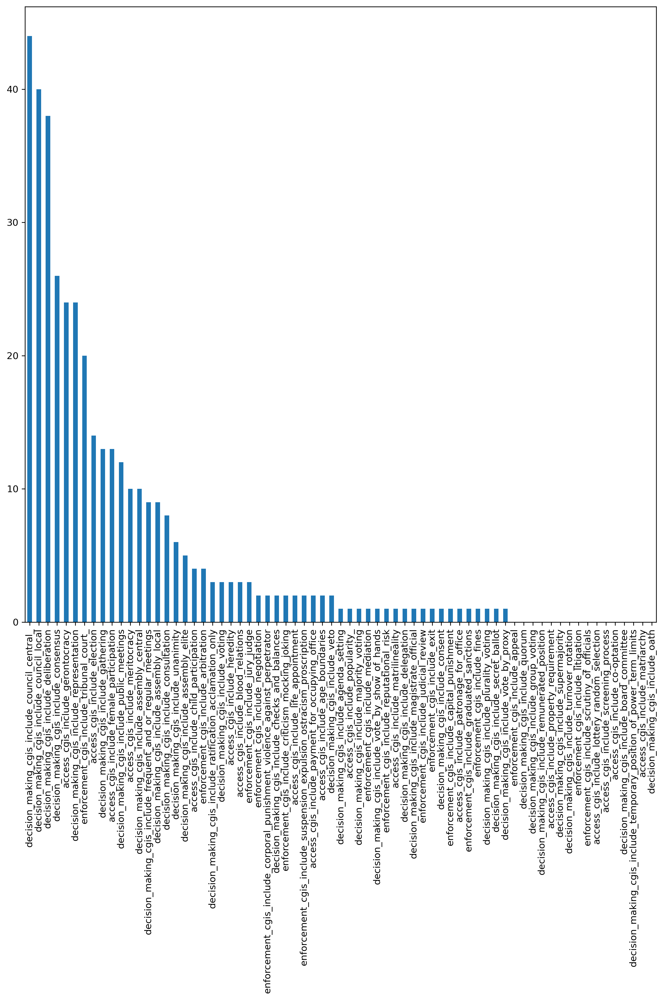

In [18]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [19]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [20]:
cgi_df[access_cgis]

,access_cgis_include_patronage_for_office,access_cgis_include_property_requirement,access_cgis_include_blood_relations,access_cgis_include_gerontocracy,access_cgis_include_age_boundaries,access_cgis_include_meritocracy,access_cgis_include_payment_for_occupying_office,access_cgis_include_child_participation,access_cgis_include_female_participation,access_cgis_include_heredity,access_cgis_include_election,access_cgis_include_co-optation,access_cgis_include_lottery_random_selection,access_cgis_include_screening_process,access_cgis_include_life_appointment,access_cgis_include_matrilineality,access_cgis_include_matriarchy,access_cgis_include_popularity_
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
12,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

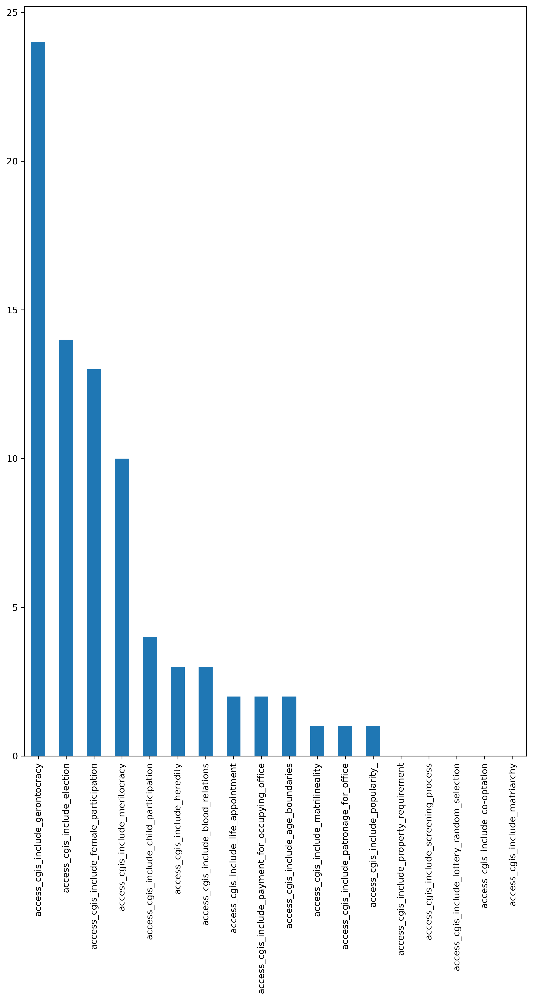

In [21]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [22]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

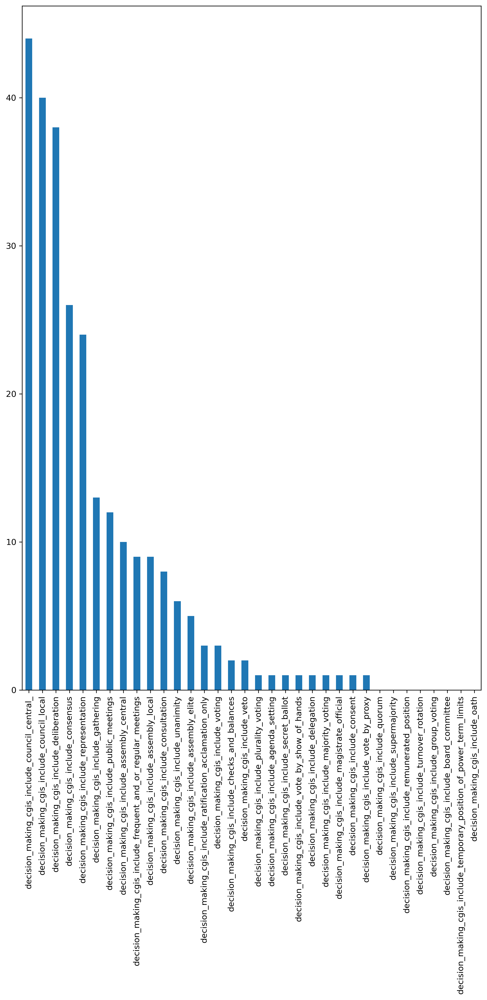

In [23]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [24]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

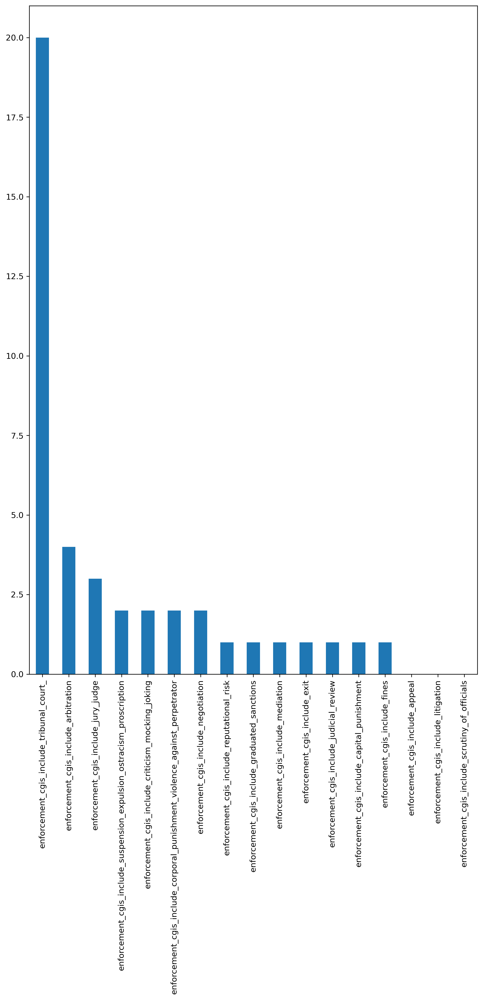

In [25]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

# CGI Mechanism Analysis 

In [26]:
# Select columns of interest

In [27]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_representation',
 'enforcement_mechanisms_include_paying_damages_compensation',
 'decision_making_mechanisms_include_temporary_position_of_power_term_limits',
 'enforcement_mechanisms_include_forced_labour',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_property_requirement',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_majority_voting',
 'enforcement_mechanisms_include_graduated_sanctions',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_assembly_local',
 'decision_making_mechanisms_include_petition',
 'access_mechanisms_include_enfranchiseme

In [28]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [29]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [30]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_representation',
 'enforcement_mechanisms_include_paying_damages_compensation',
 'decision_making_mechanisms_include_temporary_position_of_power_term_limits',
 'enforcement_mechanisms_include_forced_labour',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_property_requirement',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_majority_voting',
 'enforcement_mechanisms_include_graduated_sanctions',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_assembly_local',
 'decision_making_mechanisms_include_petition',
 'access_mechanisms_include_enfranchiseme

## Normalized Correlation Matrix

In [31]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [32]:
data_plot.describe()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanisms_include_popularity_,enforcement_mechanisms_include_seizing_of_property,access_mechanisms_include_

In [33]:
data_plot

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanisms_include_popularity_,enforcement_mechanisms_include_seizing_of_property,access_mechanisms_include_

In [34]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanisms_include_popularity_,enforcement_mechanisms_include_seizing_of_property,access_mechanisms_include_

In [35]:
norm_corr.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanisms_include_popularity_,enforcement_mechanisms_include_seizing_of_property,access_mechanisms_include_

# Visualize and Sort CGI Correlations

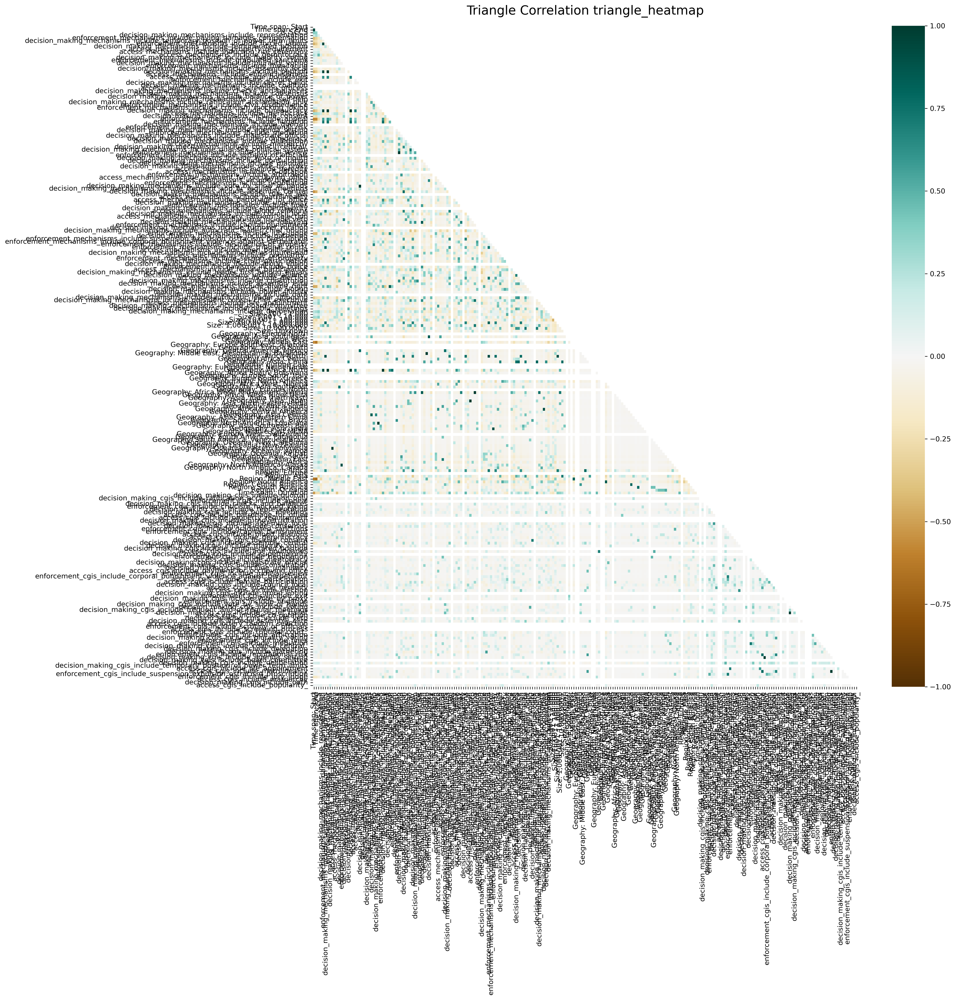

In [36]:
plt.figure(figsize=(20,20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

In [37]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

['decision_making_cgis_include_quorum',
 'decision_making_cgis_include_ratification_acclamation_only',
 'enforcement_cgis_include_appeal',
 'decision_making_cgis_include_checks_and_balances',
 'enforcement_cgis_include_criticism_mocking_joking',
 'decision_making_cgis_include_representation',
 'decision_making_cgis_include_public_meetings',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_property_requirement',
 'decision_making_cgis_include_turnover_rotation',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_consensus',
 'enforcement_cgis_include_graduated_sanctions',
 'enforcement_cgis_include_capital_punishment',
 'access_cgis_include_blood_relations',
 'access_cgis_include_gerontocracy',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_assembly_central',
 'decision_making_cgis_include_majority_voting',
 'decision_making_cgis_include_remunerated_position',
 'access_cgis_include_age_boundaries',
 'decision_making_

In [38]:
cgis_df = norm_corr[cgis_list]

In [39]:
cgis_df

,decision_making_cgis_include_quorum,decision_making_cgis_include_ratification_acclamation_only,enforcement_cgis_include_appeal,decision_making_cgis_include_checks_and_balances,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_representation,decision_making_cgis_include_public_meetings,access_cgis_include_patronage_for_office,access_cgis_include_property_requirement,decision_making_cgis_include_turnover_rotation,decision_making_cgis_include_assembly_local,decision_making_cgis_include_consensus,enforcement_cgis_include_graduated_sanctions,enforcement_cgis_include_capital_punishment,access_cgis_include_blood_relations,access_cgis_include_gerontocracy,decision_making_cgis_include_consent,decision_making_cgis_include_assembly_central,decision_making_cgis_include_majority_voting,decision_making_cgis_include_remunerated_position,access_cgis_include_age_boundaries,decision_making_cgis_include_supermajority,enforcement_cgis_include_negotiation,access_cgis_include_meritocracy,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_consultation,decision_making_cgis_include_unanimity,access_cgis_include_payment_for_occupying_office,enforcement_cgis_include_judicial_review,enforcement_cgis_include_corporal_punishment_violence_against_perpetrator,access_cgis_include_child_participation,access_cgis_include_female_participation,decision_making_cgis_include_council_local,access_cgis_include_heredity,access_cgis_include_election,decision_making_cgis_include_group_voting,enforcement_cgis_include_exit,decision_making_cgis_include_vote_by_proxy,enforcement_cgis_include_litigation,decision_making_cgis_include_vote_by_show_of_hands,decision_making_cgis_include_voting,decision_making_cgis_include_frequent_and_or_regular_meetings,decision_making_cgis_include_secret_ballot,access_cgis_include_co-optation,decision_making_cgis_include_veto,decision_making_cgis_include_assembly_elite,access_cgis_include_lottery_random_selection,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_screening_process,enforcement_cgis_include_tribunal_court_,enforcement_cgis_include_arbitration,decision_making_cgis_include_plurality_voting,enforcement_cgis_include_fines,enforcement_cgis_include_mediation,decision_making_cgis_include_council_central_,decision_making_cgis_include_delegation,decision_making_cgis_include_gathering,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_board_committee,decision_making_cgis_include_deliberation,decision_making_cgis_include_temporary_position_of_power_term_limits,access_cgis_include_life_appointment,access_cgis_include_matrilineality,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,enforcement_cgis_include_jury_judge,access_cgis_include_matriarchy,decision_making_cgis_include_oath,access_cgis_include_popularity_
Time span: Start,NaN,-0.025458,NaN,0.018539,0.041850,0.087733,0.001786,0.027111,NaN,NaN,-0.058246,0.123737,0.029551,0.027784,0.036491,0.132544,0.029653,-0.207215,0.029551,NaN,0.037916,NaN,0.038556,0.077673,0.022959,-0.077025,0.024974,0.010754,0.010896,0.034175,0.058232,0.078710,0.102999,0.036673,-0.038102,NaN,0.019959,0.029230,NaN,0.029653,0.038885,0.034955,0.029653,NaN,0.039870,-0.059015,NaN,NaN,NaN,-0.033774,0.047084,0.029162,0.029551,0.027111,-0.044006,0.019959,0.052361,0.010096,0.010896,NaN,0.111754,NaN,0.039788,0.010096,0.041850,-0.195196,NaN,NaN,0.027370
Time span: End,NaN,-0.033065,NaN,0.041993,0.030418,0.110930,0.009133,0.023604,NaN,NaN,-0.047713,0.130984,0.021479,0.023058,0.043474,0.118944,0.021381,-0.160319,0.021479,NaN,0.033442,NaN,0.033272,0.077727,0.026408,-0.033800,0.018330,0.043749,0.030716,0.035401,0.044116,0.091782,0.109832,0.044556,-0.006815,NaN,0.027938,0.021783,NaN,0.021381,0.044615,0.044623,0.021381,NaN,0.032086,-0.021878,NaN,NaN,NaN,-0.031484,0.051351,0.021846,0.021479,0.023604,-0.010857,0.027938,0.078343,0.030853,0.030716,NaN,0.123465,NaN,0.032278,0.030853,0.

In [40]:
query_cgis_df = cgis_df.transpose()

In [41]:
query_cgis_df.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_paying_damages_compensation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_property_requirement,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_majority_voting,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_petition,access_mechanisms_include_enfranchisement,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_coalition,access_mechanisms_include_screening_process,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_delegation,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_judicial_review,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_heredity,access_mechanisms_include_co-optation,enforcement_mechanisms_include_arbitration,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_dreaming,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_matrilineality,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_supermajority,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_council_local,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_tribunal_court_,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_kingchief-as-figurehead,access_mechanisms_include_popularity_,enforcement_mechanisms_include_seizing_of_property,access_mechanisms_include_

## Time x Region x Size for CGIs

In [42]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [43]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [44]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [45]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_representation',
 'enforcement_mechanisms_include_paying_damages_compensation',
 'decision_making_mechanisms_include_temporary_position_of_power_term_limits',
 'enforcement_mechanisms_include_forced_labour',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_property_requirement',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_majority_voting',
 'enforcement_mechanisms_include_graduated_sanctions',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_assembly_local',
 'decision_making_mechanisms_include_petition',
 'access_mechanisms_include_enfranchiseme

## Time x CGIs

In [46]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
decision_making_cgis_include_quorum,NaN,NaN,NaN
decision_making_cgis_include_ratification_acclamation_only,-0.025458,-0.033065,-0.013292
enforcement_cgis_include_appeal,NaN,NaN,NaN
decision_making_cgis_include_checks_and_balances,0.018539,0.041993,0.064406
enforcement_cgis_include_criticism_mocking_joking,0.041850,0.030418,-0.051273
decision_making_cgis_include_representation,0.087733,0.110930,0.036588
decision_making_cgis_include_public_meetings,0.001786,0.009133,0.021745
access_cgis_include_patronage_for_office,0.027111,0.023604,-0.021306
access_cgis_include_property_requirement,NaN,NaN,NaN
decision_making_cgis_include_turnover_rotation,NaN,NaN,NaN


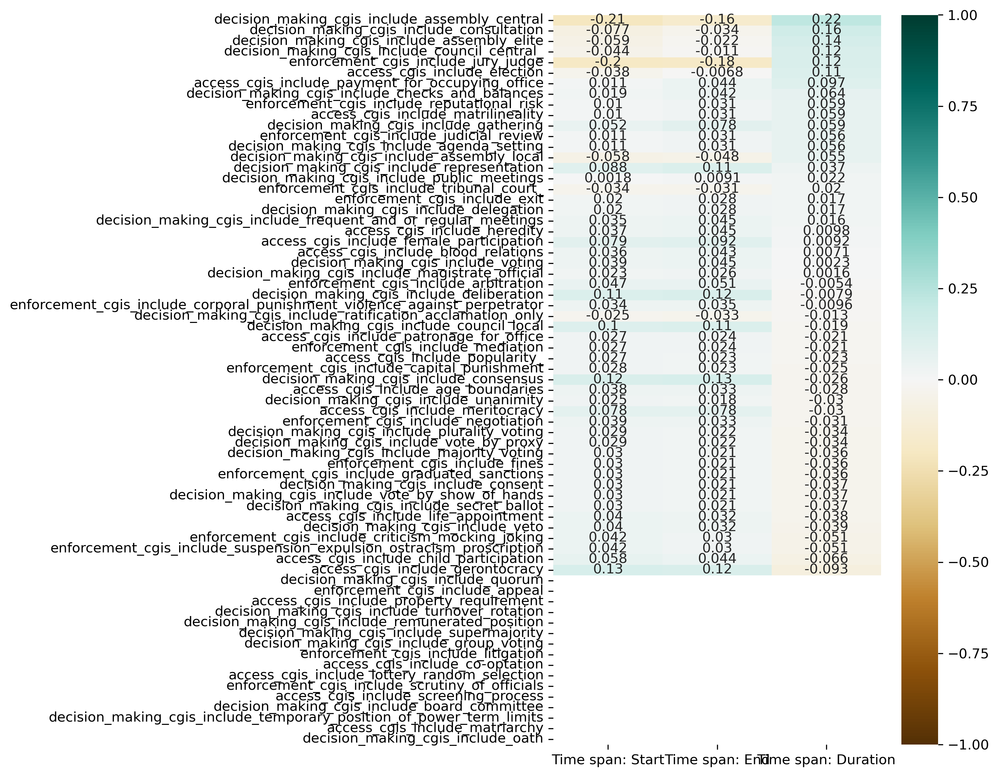

In [47]:
plt.figure(figsize=(10,8))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [48]:
access_cgis

['access_cgis_include_patronage_for_office',
 'access_cgis_include_property_requirement',
 'access_cgis_include_blood_relations',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_age_boundaries',
 'access_cgis_include_meritocracy',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_child_participation',
 'access_cgis_include_female_participation',
 'access_cgis_include_heredity',
 'access_cgis_include_election',
 'access_cgis_include_co-optation',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_screening_process',
 'access_cgis_include_life_appointment',
 'access_cgis_include_matrilineality',
 'access_cgis_include_matriarchy',
 'access_cgis_include_popularity_']

In [49]:
time_access_cgis = time_cgis.loc[access_cgis]

In [50]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_patronage_for_office,0.027111,0.023604,-0.021306
access_cgis_include_property_requirement,NaN,NaN,NaN
access_cgis_include_blood_relations,0.036491,0.043474,0.007076
access_cgis_include_gerontocracy,0.132544,0.118944,-0.093334
access_cgis_include_age_boundaries,0.037916,0.033442,-0.028483
access_cgis_include_meritocracy,0.077673,0.077727,-0.030181
access_cgis_include_payment_for_occupying_office,0.010754,0.043749,0.096597
access_cgis_include_child_participation,0.058232,0.044116,-0.065873
access_cgis_include_female_participation,0.078710,0.091782,0.009183
access_cgis_include_heredity,0.036673,0.044556,0.009754


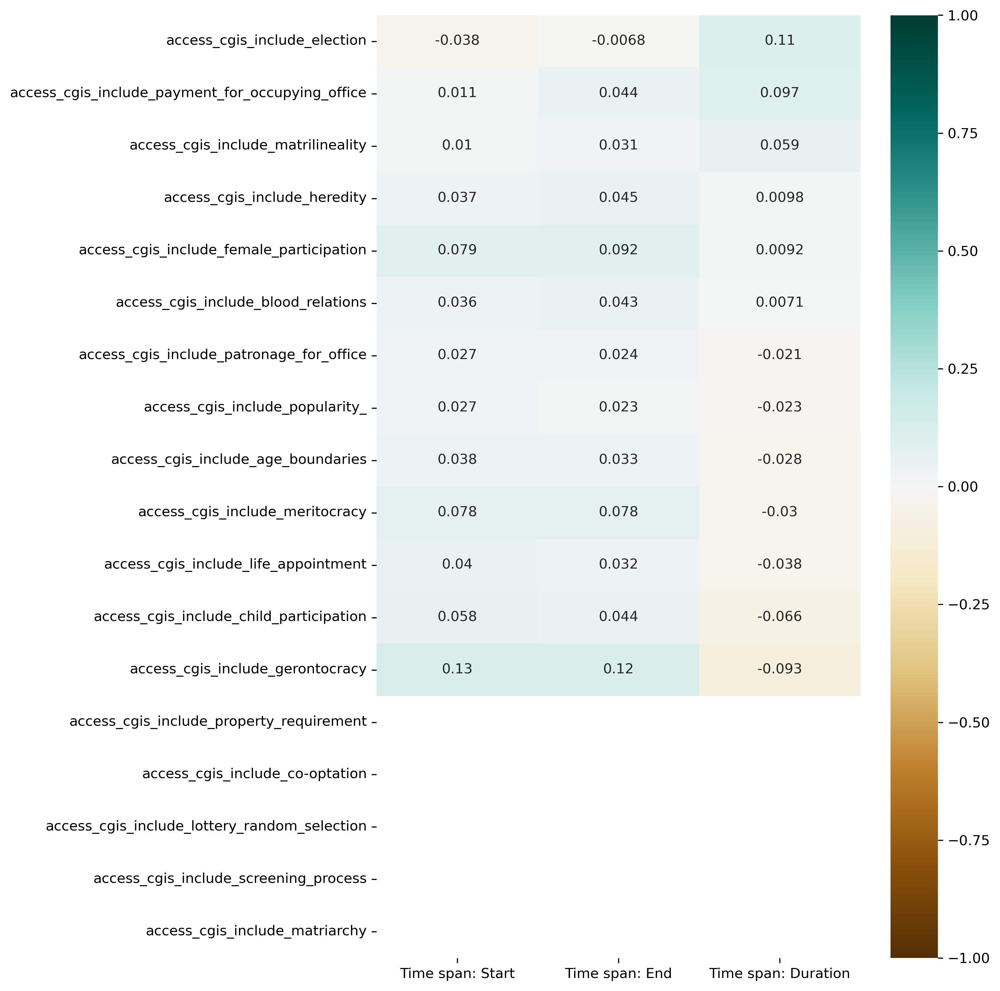

In [51]:
plt.figure(figsize=(10,10))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [52]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

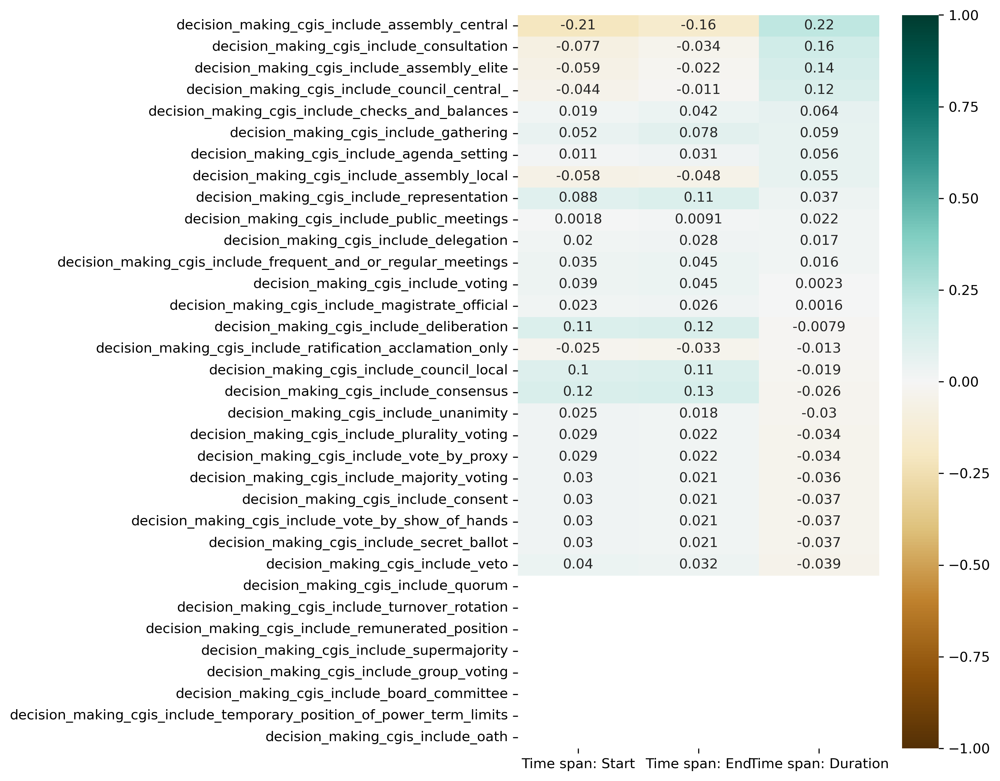

In [53]:
plt.figure(figsize=(10,8))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [54]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

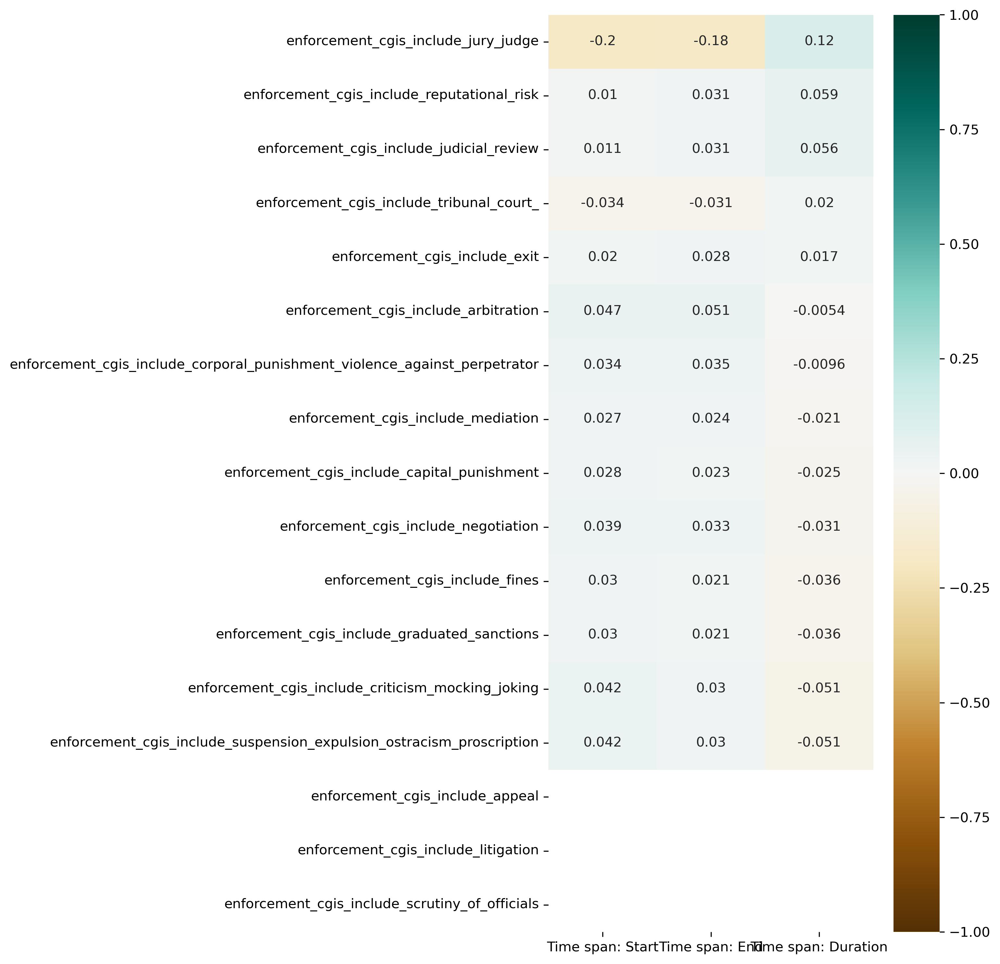

In [55]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [56]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
decision_making_cgis_include_quorum,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_ratification_acclamation_only,-0.036859,NaN,0.067611,0.034894,-0.002899,-0.019561,-0.014207,-0.023265
enforcement_cgis_include_appeal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_checks_and_balances,0.046992,NaN,-0.038880,-0.024319,-0.045796,-0.016254,-0.011805,0.122174
enforcement_cgis_include_criticism_mocking_joking,-0.030829,NaN,0.028505,-0.024478,0.033519,-0.016360,-0.011882,-0.019458
decision_making_cgis_include_representation,-0.009854,NaN,0.056550,-0.086415,0.048179,-0.057757,-0.041948,-0.020956
decision_making_cgis_include_public_meetings,-0.050383,NaN,0.139710,-0.056429,0.000635,0.007739,0.077589,0.006041
access_cgis_include_patronage_for_office,-0.021769,NaN,0.075897,-0.017284,-0.032549,-0.011552,-0.008390,-0.013740
access_cgis_include_property_requirement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_turnover_rotation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

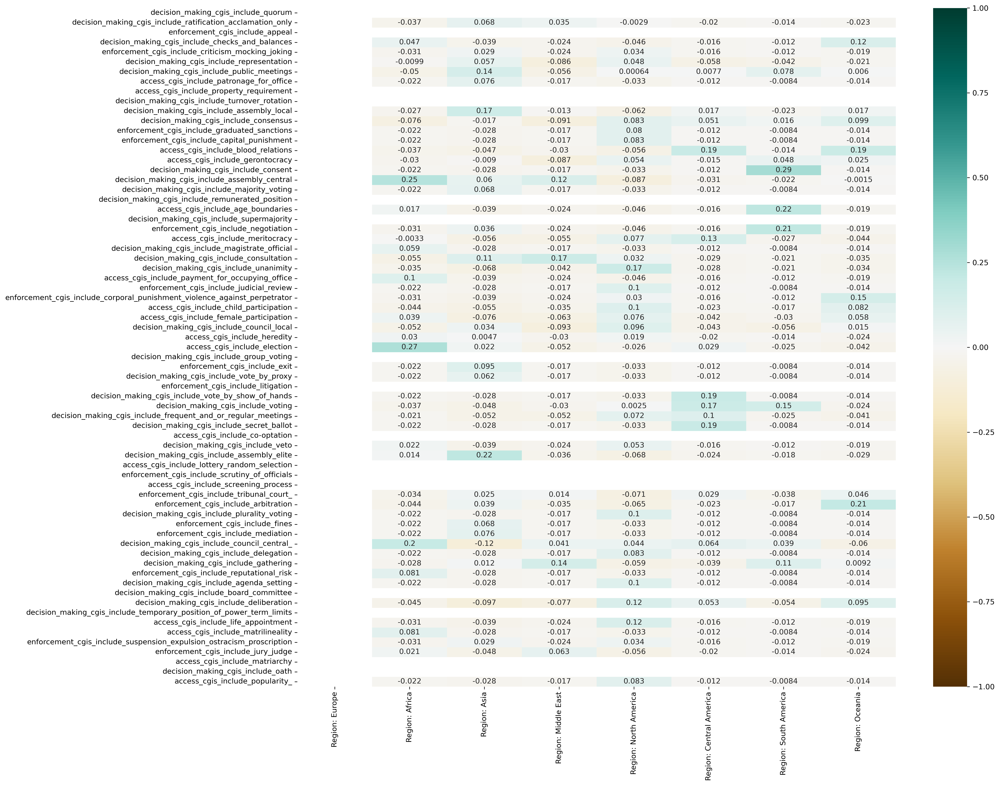

In [58]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [59]:
region_access_cgis = region_cgis.loc[access_cgis]

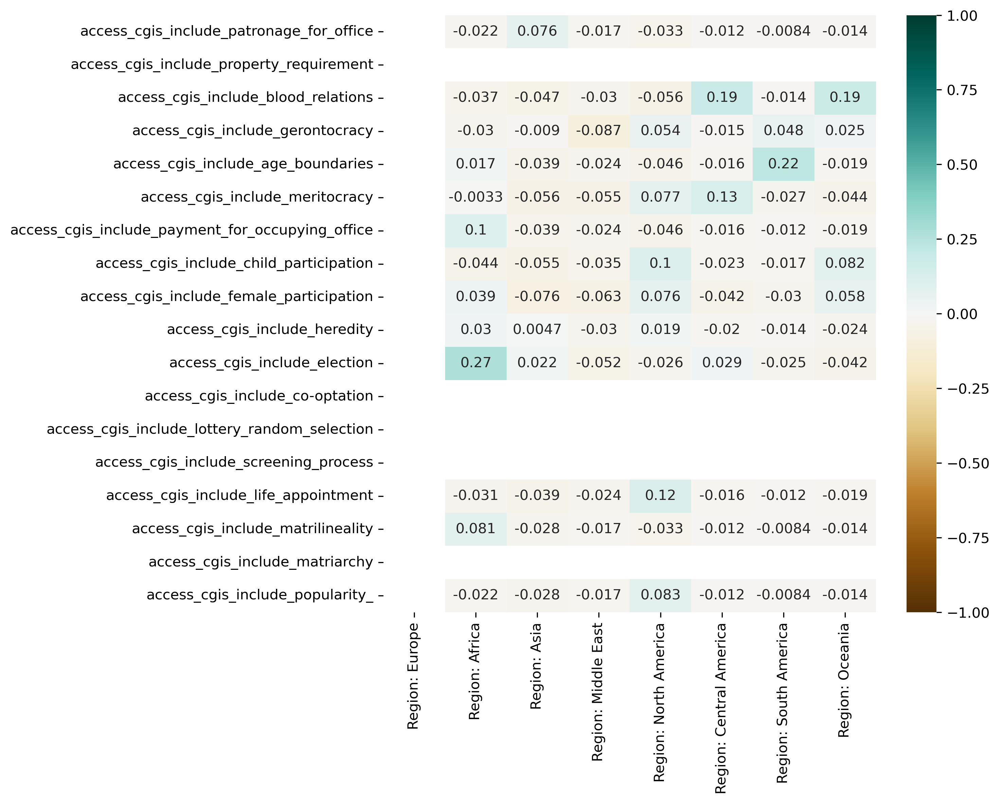

In [60]:
plt.figure(figsize=(10,8))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [61]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

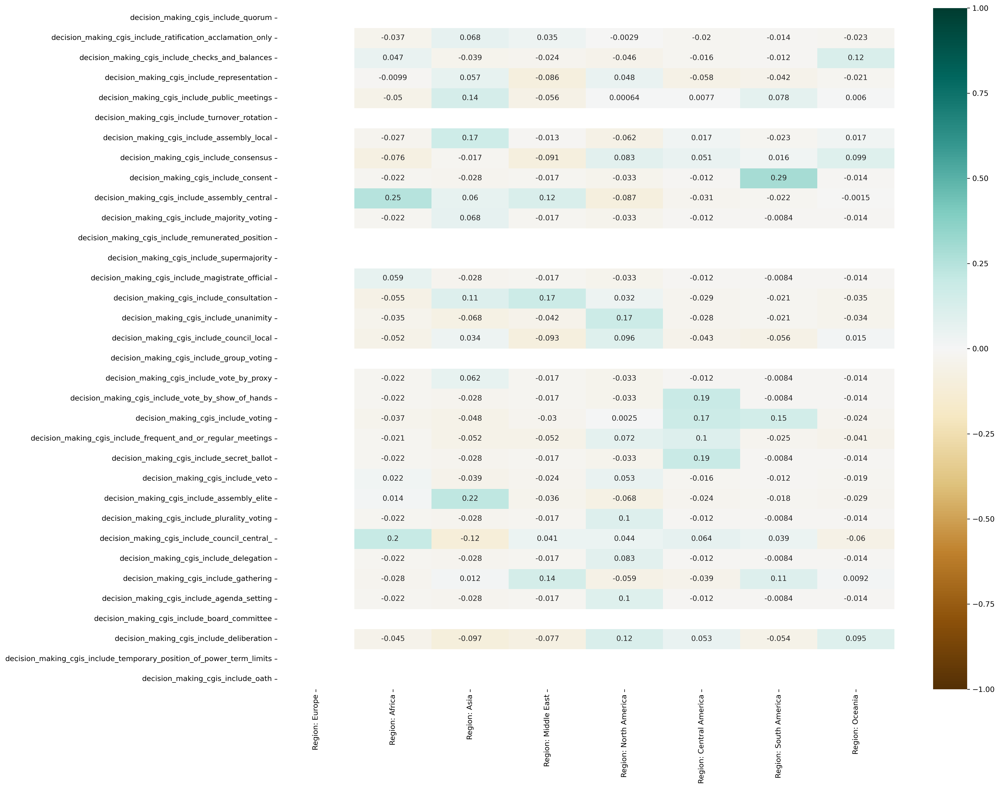

In [62]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [63]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

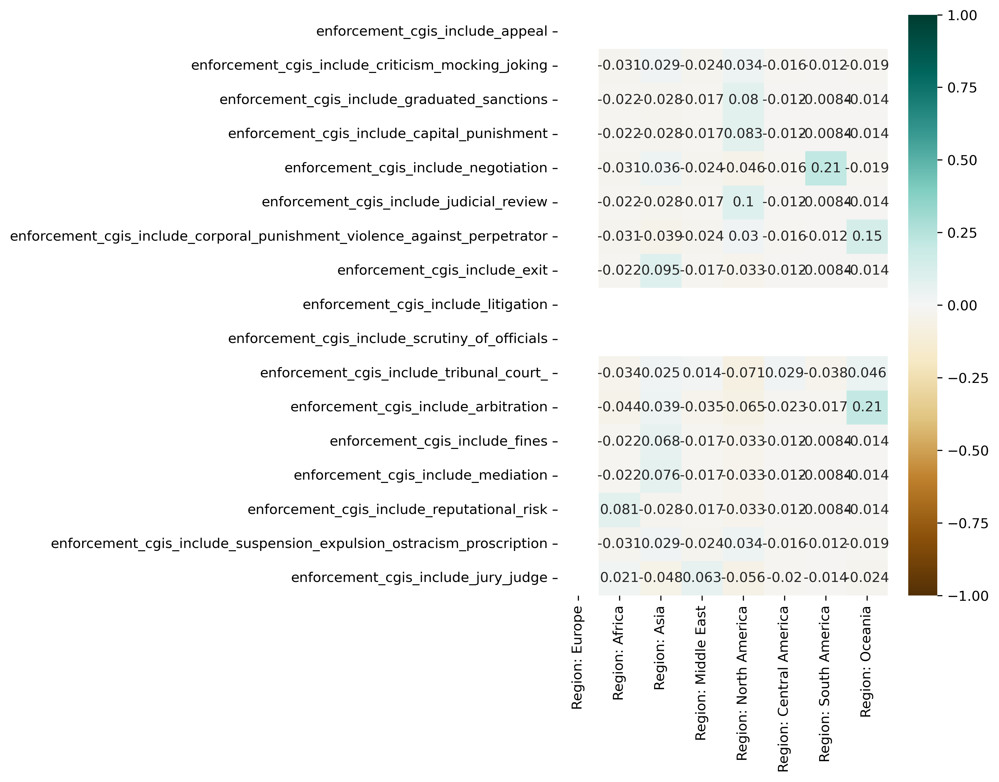

In [64]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [65]:
size_cgis = query_cgis_df[size_cols]

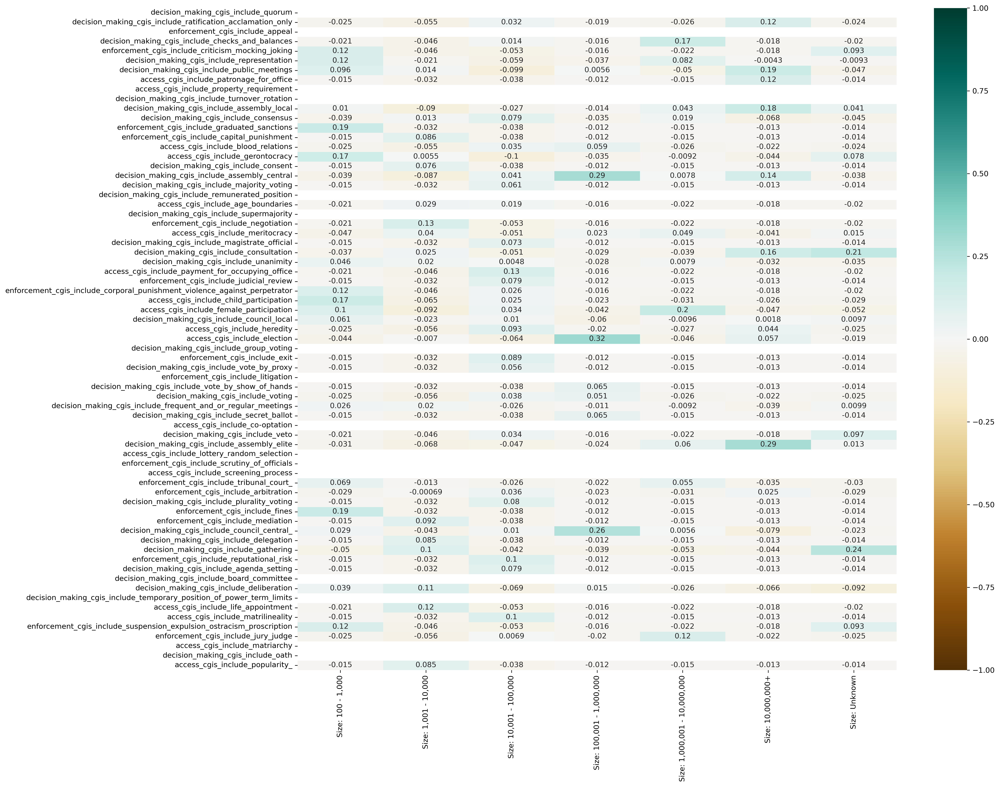

In [66]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [67]:
size_access_cgis = size_cgis.loc[access_cgis]

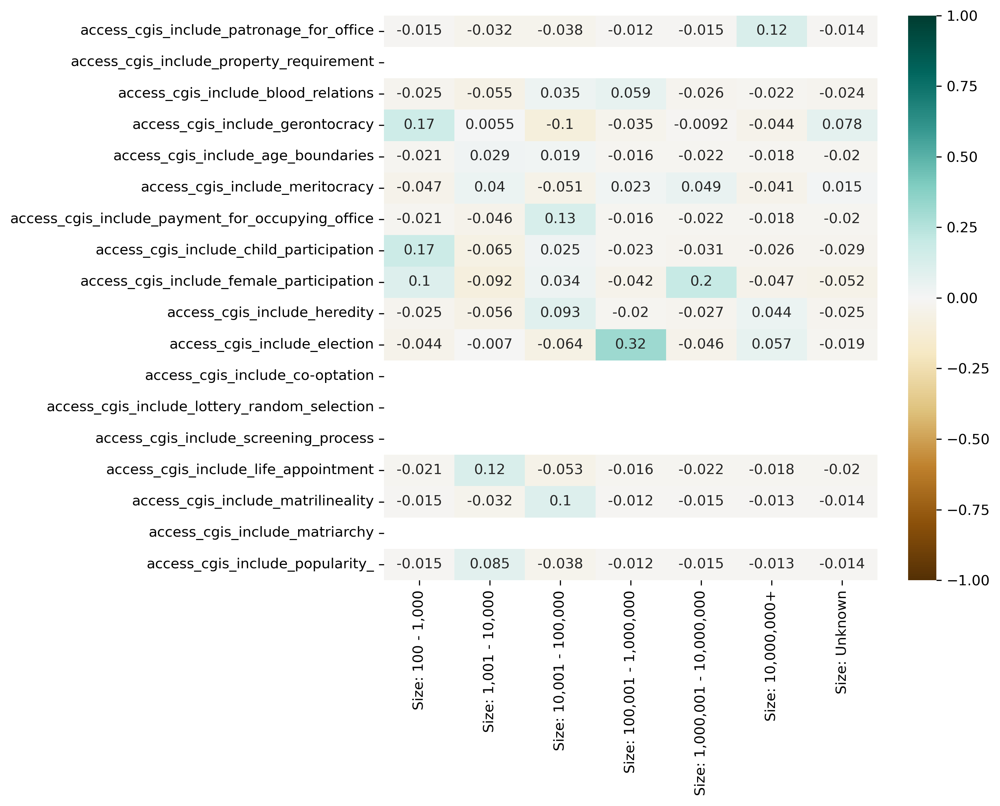

In [68]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [69]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

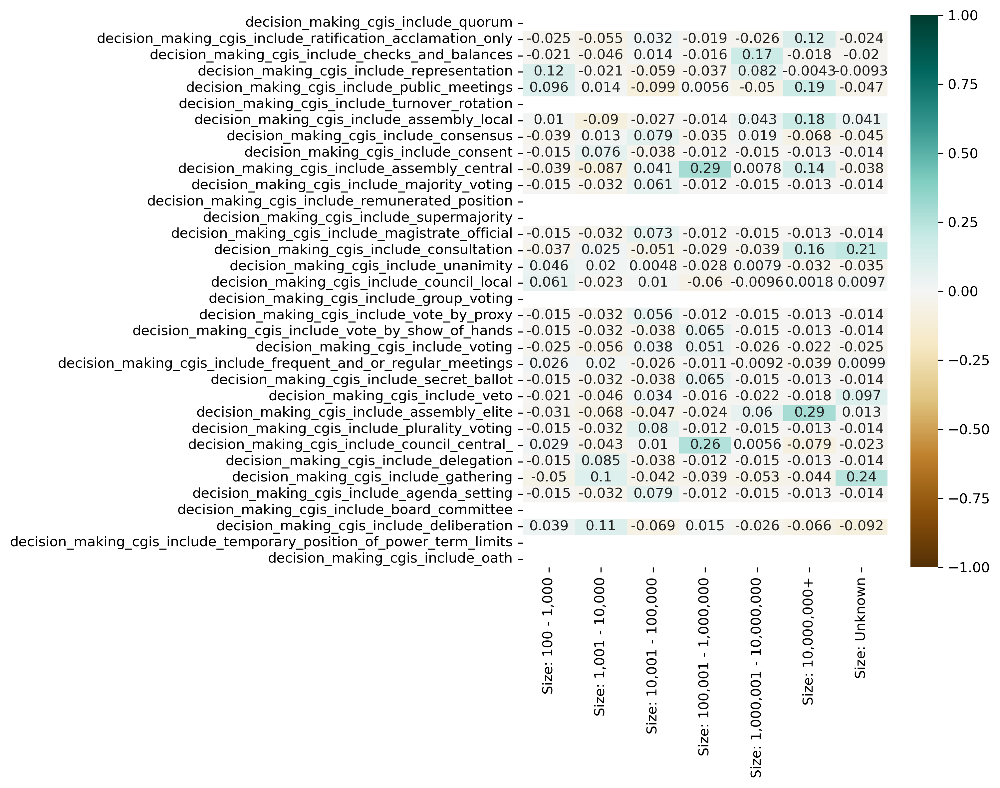

In [70]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [71]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

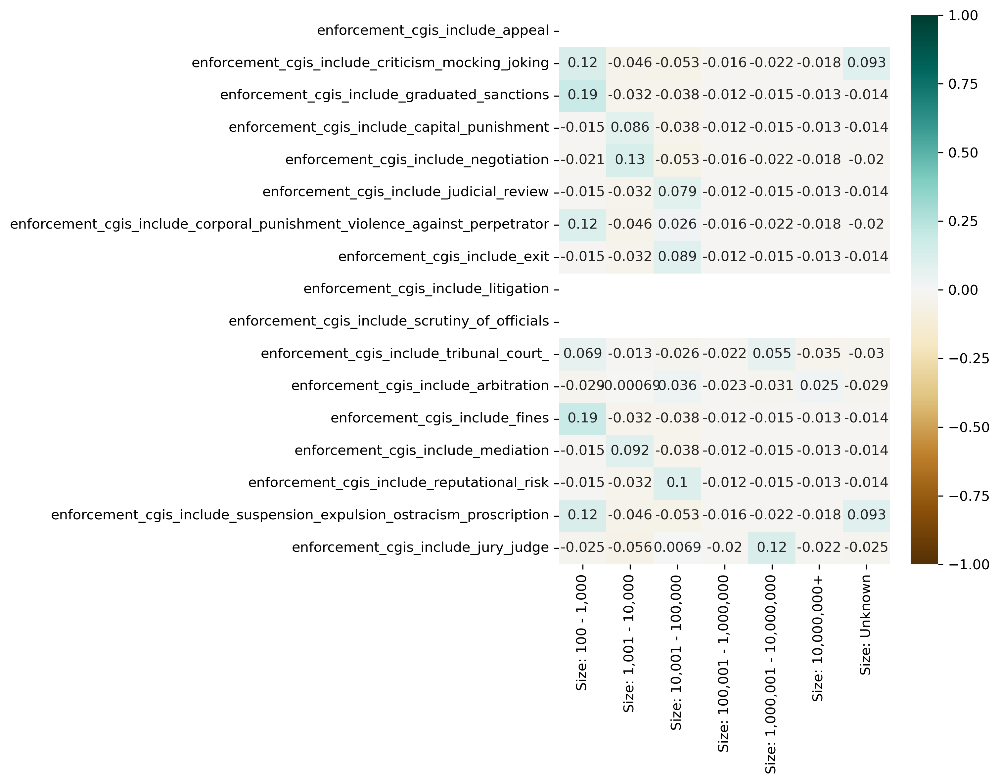

In [72]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [73]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [74]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [75]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_petition        decision_making_mechanisms_include_bureaucracy    1.0
decision_making_mechanisms_include_agenda_setting  enforcement_mechanisms_include_judicial_review    1.0
access_mechanisms_include_property_requirement     Geography: Oceania, eastern Polynesia             1.0
enforcement_cgis_include_judicial_review           decision_making_cgis_include_agenda_setting       1.0
enforcement_mechanisms_include_civil_disobedience  Geography: North America, Louisiana               1.0
                                                                                                    ... 
enforcement_cgis_include_jury_judge                access_cgis_include_matriarchy                    NaN
                                                   decision_making_cgis_include_oath                 NaN
access_cgis_include_matriarchy                     decision_making_cgis_include_oath                 NaN
                                                   acce

In [76]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + '/SCCS/cgis_all_correlations.csv')

In [77]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: End                       Region: Middle East                     -0.675401
                                     Geography: Middle East                  -0.641734
Time span: Start                     Region: Middle East                     -0.633173
                                     enforcement_mechanisms_include_appeal   -0.590140
Time span: End                       enforcement_mechanisms_include_appeal   -0.577485
                                                                                ...   
enforcement_cgis_include_jury_judge  access_cgis_include_matriarchy                NaN
                                     decision_making_cgis_include_oath             NaN
access_cgis_include_matriarchy       decision_making_cgis_include_oath             NaN
                                     access_cgis_include_popularity_               NaN
decision_making_cgis_include_oath    access_cgis_include_popularity_               NaN
Length: 27966, dtype: float64


In [78]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/SCCS/cgis_negative_correlations.csv')